In [1]:
import torch
from torch.utils.data import DataLoader
import torchvision.transforms as T

import cv2
from PIL import Image
import numpy as np
import pandas as pd
import os
import sys
from tqdm import tqdm

import importlib

import matplotlib.pyplot as plt
from matplotlib import gridspec

# from matplotlib.axes import Subplot

import random

from scipy.stats import skew

In [2]:
class PathDataset(torch.utils.data.Dataset):
    def __init__(self, image_path_list, parent_dir, transform=None):
        self.image_path_list = image_path_list
        self.parent_dir = parent_dir
        self.transform = transform

    def __getitem__(self, idx):
        if ".jpg" in self.image_path_list[idx]:
            print(self.image_path_list[idx])
            return self.image_path_list[idx]
        suffix = ".jpg"
        image_path = os.path.join(self.parent_dir, self.image_path_list[idx]) + suffix
        # image = Image.open(image_path)
        # if self.transform:
        #     image = self.transform(image)
        # print(image_path)
        return image_path

    def __len__(self):
        return len(self.image_path_list)

In [ ]:
current_path = os.getcwd()
data_path = os.path.join(current_path, "data")
image_dir = "Fitzpatric_subset"
# data_csv = os.path.join(data_path, "data.csv")
data_csv = os.path.join(
    data_path, "annotated_data.csv"
)  # Load annotated data for each artifact

data = pd.read_csv(data_csv)
image_path_list = data["image_path"].tolist()


path_dataset = PathDataset(image_path_list, os.path.join(data_path, image_dir), None)
path_loader = DataLoader(path_dataset, batch_size=8, shuffle=False, num_workers=0)
print(f"{len(path_dataset)} images in the dataset")

4311 images in the dataset


In [4]:
# glare detection
def detect_glare(image_path):
    threshold = 250
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    glare_mask = gray > threshold
    # filter out the pixels that are brighter than the threshold
    # doesn't neccesarily mean glare, bright objects can generate high intensity pixels
    glare_ratio = np.sum(glare_mask) / (gray.shape[0] * gray.shape[1])
    return glare_ratio  # >0.01 may indicate glare


def histogram_skewness(image_path):
    img = cv2.imread(image_path)
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    hist = cv2.calcHist([gray_img], [0], None, [256], [0, 256]).flatten()
    pixel_vals = np.arange(256)
    return skew(np.repeat(pixel_vals, hist.astype(int)))


def detect_blur(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    laplacian_var = cv2.Laplacian(gray, cv2.CV_64F).var()
    return laplacian_var


def non_skin_ratio(image_path):
    img = cv2.imread(image_path)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lower_skin = np.array([0, 50, 80])
    upper_skin = np.array([50, 170, 255])

    skin_mask = cv2.inRange(hsv, lower_skin, upper_skin)
    skin_pixels = np.sum(skin_mask > 0)
    total_pixels = skin_mask.size
    return 1 - (skin_pixels / total_pixels)

In [5]:
def artifact_process(data_loader, artifact, func) -> list[float]:
    results = list()

    for batch in tqdm(data_loader, desc=f"Processing {artifact}"):
        for path in batch:
            ratio = func(path)
            results.append(ratio)

    # data[artifact] = results
    # data.to_csv(f"data_with_{artifact}.csv", index=False)

    return results

In [6]:
size = 224
transform = T.Resize(size=size, interpolation=T.InterpolationMode.BICUBIC)


def example_plot(scores, artifact, suptitle, desc=True, num_example=200, num_column=20):

    fig = plt.figure(
        figsize=(
            num_column * 2,
            1.3 * (num_example // num_column + 1) * 2,
        ),
        facecolor="white",
    )

    main_gs = gridspec.GridSpec(1, 1, figure=fig)

    nested_gs = gridspec.GridSpecFromSubplotSpec(
        num_example // num_column + (1 if num_example % num_column > 0 else 0),
        num_column,
        subplot_spec=main_gs[0],
        wspace=0,
        hspace=0.1,
        width_ratios=[1] * num_column,
    )

    axd = dict()

    for rank_num in tqdm(range(num_example), desc="Processing examples"):
        ax = fig.add_subplot(nested_gs[rank_num])

        if desc:
            sorted_score_idx = np.argsort(scores)[::-1]
        else:
            sorted_score_idx = np.argsort(scores)
        image_path = path_dataset[sorted_score_idx[rank_num]]
        image = Image.open(image_path)
        ax.imshow(transform(image))
        ax.axis("off")

        plot_key = rank_num
        axd[plot_key] = ax

        axd[plot_key].set_title(
            f"Rank: {rank_num}\nScore: {scores[sorted_score_idx[rank_num]]:.2f}",
            fontsize=8,
        )

        plt.tight_layout()
        plt.suptitle(f"{suptitle}", fontsize=16, fontweight="bold", y=1.005)

Processing examples: 100%|██████████| 200/200 [03:34<00:00,  1.07s/it]


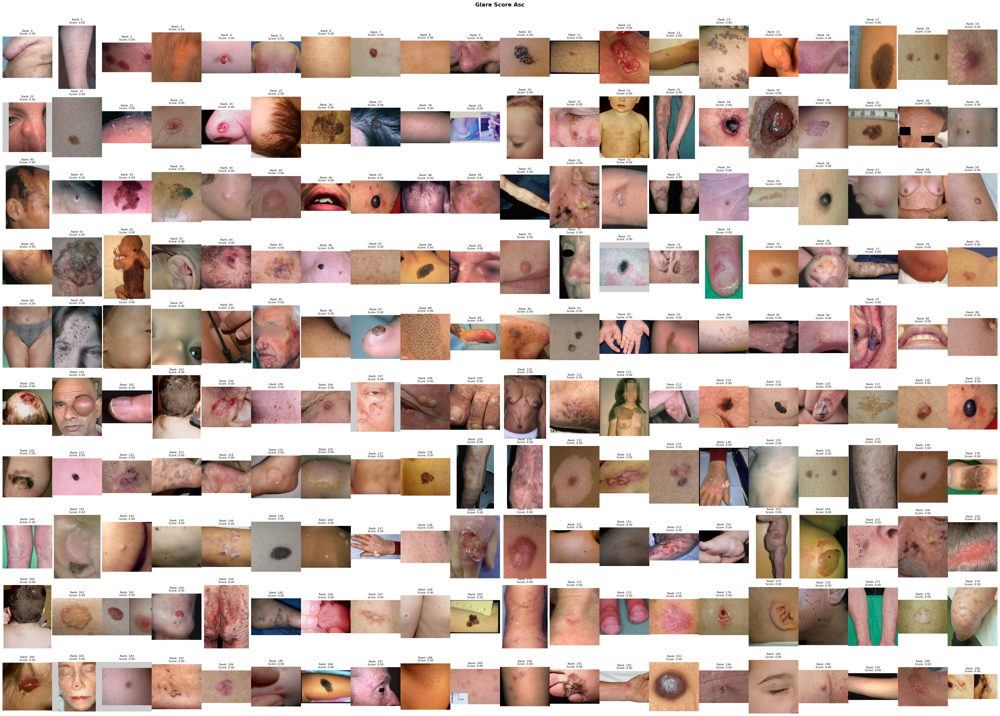

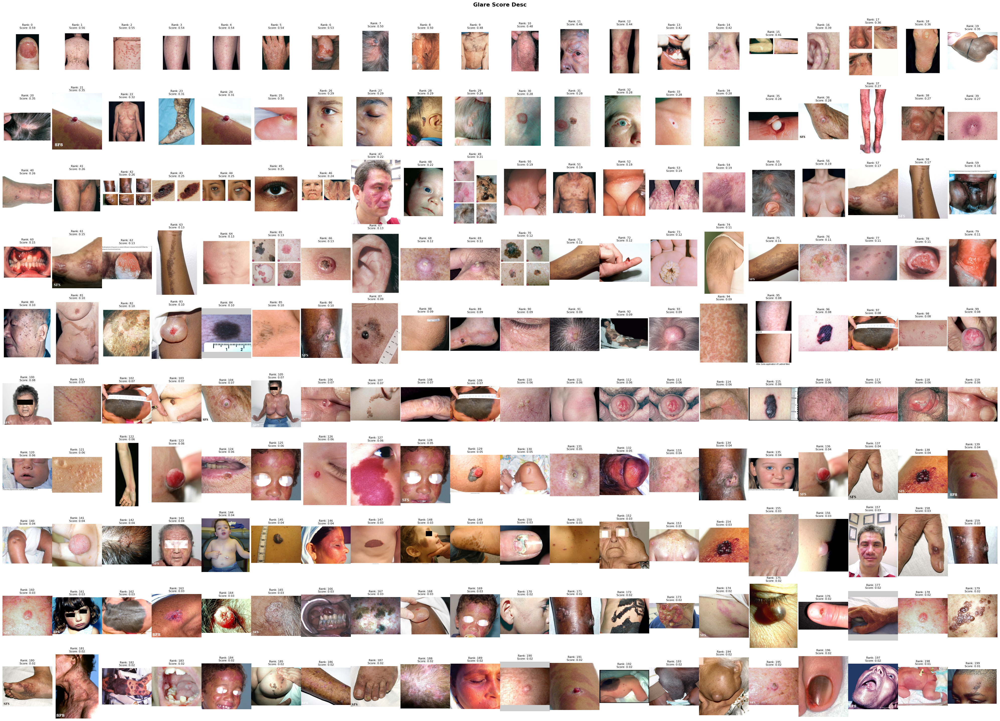

In [16]:
artifact = "glare"

results = artifact_process(
    data_loader=path_loader, artifact=artifact, func=detect_glare
)
example_plot(scores=results, artifact=artifact, suptitle=f"Glare Score Asc", desc=False)
example_plot(scores=results, artifact=artifact, suptitle=f"Glare Score Desc")

In [ ]:
# artifact = "skewness"

# results = artifact_process(
#     data_loader=path_loader, artifact=artifact, func=histogram_skewness
# )
# example_plot(
#     scores=results, artifact=artifact, suptitle=f"Skewness Score Asc", desc=False
# )
# example_plot(scores=results, artifact=artifact, suptitle=f"Skewness Score Desc")

In [9]:
# artifact = "blurness"

# results = artifact_process(data_loader=path_loader, artifact=artifact, func=detect_blur)
# example_plot(
#     scores=results, artifact=artifact, suptitle=f"Blurness Score Desc", desc=False
# )

In [10]:
# artifact = "non_skin"

# results = artifact_process(
#     data_loader=path_loader, artifact=artifact, func=non_skin_ratio
# )
# example_plot(scores=results, artifact=artifact, suptitle=f"Non Skin Score Desc")
# example_plot(
#     scores=results, artifact=artifact, suptitle=f"Non Skin Score Asc", desc=False
# )

In [11]:
path = os.path.abspath("GroundingDINO")
# print(f"path = {path}")

if path not in sys.path:
    sys.path.insert(0, path)
else:
    print(f"{path} exists in system paths")

In [12]:
import groundingdino.util.inference

# Reload the modified functions
importlib.reload(groundingdino.util.inference)
from groundingdino.util.inference import load_model, load_image, predict, annotate

In [ ]:
# Load model
loaded = False

if not loaded:
    model = load_model(
        "./GroundingDINO_SwinT_OGC.py",
        "./weights/groundingdino_swint_ogc.pth",
    )
    print("Model loaded")
    loaded = True

current path = c:\MasterWanye3.0\ECE699\Artifacts detection
final text_encoder_type: bert-base-uncased


Model loaded


In [14]:
def dino_detect(
    image_path, caption="skin", box_threshold=0.3, text_threshold=0.25, device="cpu"
):

    image_nparray, image_transformed = load_image(image_path)

    print(f"box threshold = {box_threshold}, text threshold = {text_threshold}")

    boxes, logits, phrases = predict(
        device=device,
        model=model,
        image=image_transformed,
        caption=caption,
        # fine tune the thresholds
        box_threshold=box_threshold,  # Confidence score for the object detector: Higher value = fewer, more confident boxes, Lower value = more boxes, but potentially more false positives
        text_threshold=text_threshold,  # Text–box alignment confidence: Higher value = stronger text-to-region match, Lower value = allows weaker associations to pass
    )

    print(f"Path = {image_path}")
    if phrases or logits.numel():
        print(f"logits: {logits}")
        result = "Found following objects:\n"
        for p in phrases:
            result += f"{p}\n"
        print(result)

        annotated_frame = annotate(
            image_source=image_nparray, boxes=boxes, logits=logits, phrases=phrases
        )
        plt.figure(figsize=(5, 5))
        plt.imshow(cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.show()

Detection Caption:
jewelry,watch


DINO Processing:   0%|          | 0/539 [00:00<?, ?it/s]

customized version 4: add extra white boarder
box threshold = 0.6, text threshold = 0.6
Path = c:\MasterWanye3.0\ECE699\Artifacts detection\data\Fitzpatric_subset\a562d02d7c568fcff808364b4e9adab5.jpg
logits: tensor([0.6271])
Found following objects:
watch



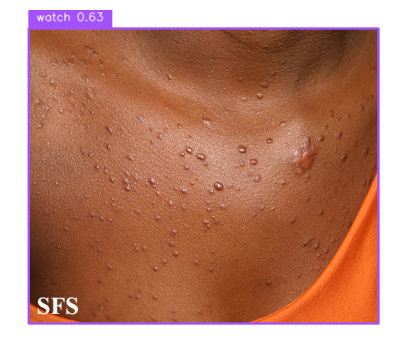

customized version 4: add extra white boarder
box threshold = 0.6, text threshold = 0.6
Path = c:\MasterWanye3.0\ECE699\Artifacts detection\data\Fitzpatric_subset\1b5084463501e9aa4d58856078f125e8.jpg
customized version 4: add extra white boarder
box threshold = 0.6, text threshold = 0.6
Path = c:\MasterWanye3.0\ECE699\Artifacts detection\data\Fitzpatric_subset\b0a513787e3c28076c3c197342be5ffa.jpg
customized version 4: add extra white boarder
box threshold = 0.6, text threshold = 0.6
Path = c:\MasterWanye3.0\ECE699\Artifacts detection\data\Fitzpatric_subset\3791b30f96733f69b473c8d2fcf3998b.jpg
customized version 4: add extra white boarder
box threshold = 0.6, text threshold = 0.6
Path = c:\MasterWanye3.0\ECE699\Artifacts detection\data\Fitzpatric_subset\45119bcf9dab198dfdfa04b14736c240.jpg
customized version 4: add extra white boarder
box threshold = 0.6, text threshold = 0.6
Path = c:\MasterWanye3.0\ECE699\Artifacts detection\data\Fitzpatric_subset\558b6378ac18ecc0c35d6b33e073d1d2.jpg


DINO Processing:   0%|          | 0/539 [00:45<?, ?it/s]


KeyboardInterrupt: 

In [15]:
import warnings

warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

artifacts = [
    "pen",
    "sticker",
    "marker",
    "cloth",
    "jewelry",
    "watch",
    "shadow",
    "light",
    "hair strands",
    "nail",
    "finger",
    "ear",
    "eye",
    "nostril",
    "lip",
    "glare",
    "blurriness",
]

accessories = ["jewelry", "watch"]

caption = ",".join(accessories)

print(f"Detection Caption:\n{caption}")

for batch in tqdm(path_loader, desc="DINO Processing"):
    for path in batch:
        dino_detect(path, caption=caption, text_threshold=0.6, box_threshold=0.6)